In [1]:
!git clone https://github.com/ayamohamdd/IP-25.git

Cloning into 'IP-25'...
remote: Enumerating objects: 709, done.
remote: Counting objects: 100% (9/9), done.
remote: Compressing objects: 100% (7/7), done.
remote: Total 709 (delta 0), reused 3 (delta 0), pack-reused 700 (from 1)
Receiving objects: 100% (709/709), 403.03 MiB | 49.79 MiB/s, done.
Updating files: 100% (691/691), done.


In [2]:
import os
import numpy as np
from PIL import Image
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator

def load_data_with_integer_encoding(image_dir, label_dir, img_size=(256, 256), augment=True, augment_factor=8):
   
    CLASS_COLORS = {
        (0, 0, 0): 0,         # Background clutter
        (128, 0, 0): 1,       # Building
        (128, 64, 128): 2,    # Road
        (0, 128, 0): 3,       # Tree
        (128, 128, 0): 4,     # Low vegetation
        (64, 0, 128): 5,      # Moving car
        (192, 0, 192): 6,     # Static car
        (64, 64, 0): 7        # Human
    }

    def rgb_to_class(label_image):
        label_array = np.zeros(label_image.shape[:2], dtype=np.uint8)
        for rgb, class_idx in CLASS_COLORS.items():
            mask = np.all(label_image == np.array(rgb), axis=-1)
            label_array[mask] = class_idx
        return label_array

    def augment_image(image, label):
        datagen = ImageDataGenerator(
            rotation_range=15,
            width_shift_range=0.1,
            height_shift_range=0.1,
            shear_range=0.1,
            zoom_range=0.1,
            horizontal_flip=True
        )
        image = image[np.newaxis, ...]
        label = label[np.newaxis, ..., np.newaxis]
    
        seed = np.random.randint(0, 1000)
        image_gen = datagen.flow(image, batch_size=1, seed=seed)
        label_gen = datagen.flow(label, batch_size=1, seed=seed)
    
        augmented_image = next(image_gen)[0]
        augmented_label = next(label_gen)[0, ..., 0]
    
        # Ensure labels are valid integers
        augmented_label = np.round(augmented_label).astype(np.uint8)
    
        return augmented_image, augmented_label


    images = []
    labels = []

    for img_name in os.listdir(image_dir):
        img_path = os.path.join(image_dir, img_name)
        label_path = os.path.join(label_dir, img_name)

        
        img = Image.open(img_path).convert('RGB').resize(img_size)
        label = Image.open(label_path).convert('RGB').resize(img_size)

       
        img_array = np.array(img, dtype=np.float32) / 255.0
        label_array = rgb_to_class(np.array(label))

       
        images.append(img_array)
        labels.append(label_array)

       
        if augment:
            for _ in range(augment_factor):
                aug_img, aug_label = augment_image(img_array, label_array)
                images.append(aug_img)
                labels.append(aug_label)

    return np.array(images), np.array(labels)



train_image_dir = "/kaggle/working/IP-25/train_data/Images"
train_label_dir = "/kaggle/working/IP-25/train_data/Labels"
val_image_dir = "/kaggle/working/IP-25/val_data/Images"
val_label_dir = "/kaggle/working/IP-25/val_data/Labels"
train_images, train_masks = load_data_with_integer_encoding(
    image_dir=train_image_dir,
    label_dir=train_label_dir,
    img_size=(256, 256),
    augment=True,
    augment_factor=8)
val_images, val_masks = load_data_with_integer_encoding(
    image_dir=val_image_dir,
    label_dir=val_label_dir,
    img_size=(256, 256),
    augment=False,
    augment_factor=8)

print(f"Training data: {train_images.shape}, {train_masks.shape}")
print(f"Validation data: {val_images.shape}, {val_masks.shape}")

Training data: (1800, 256, 256, 3), (1800, 256, 256)
Validation data: (70, 256, 256, 3), (70, 256, 256)


In [3]:
train_unique_classes = np.unique(train_masks)
val_unique_classes = np.unique(val_masks)

print(f"Unique classes in training masks: {train_unique_classes}")
print(f"Unique classes in validation masks: {val_unique_classes}")

Unique classes in training masks: [0 1 2 3 4 5 6 7]
Unique classes in validation masks: [0 1 2 3 4 5 6 7]


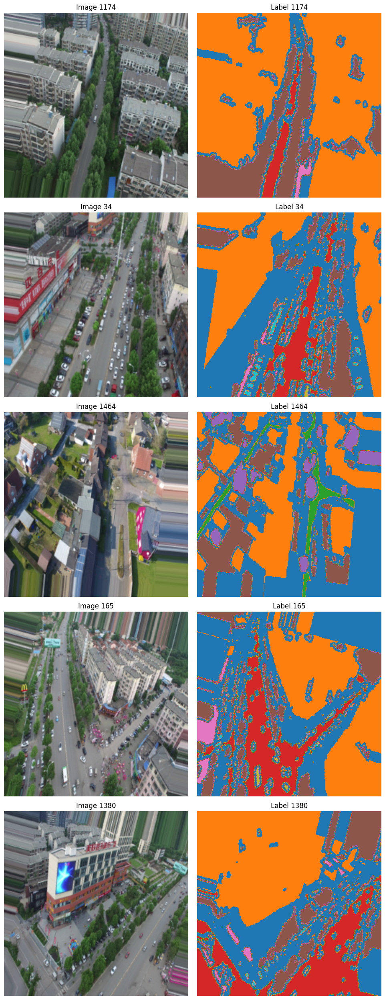

In [4]:
import matplotlib.pyplot as plt
import random

def visualize_images_and_labels(images, labels, num_images=5):
    
    fig, axes = plt.subplots(num_images, 2, figsize=(10, num_images * 5))
    
    for i in range(num_images):
       
        index = random.randint(0, len(images) - 1)
        
        
        axes[i, 0].imshow(images[index])
        axes[i, 0].set_title(f"Image {index}")
        axes[i, 0].axis('off')  
        
       
        axes[i, 1].imshow(labels[index], cmap='tab10')  
        axes[i, 1].set_title(f"Label {index}")
        axes[i, 1].axis('off')  
        
    plt.tight_layout()
    plt.show()


visualize_images_and_labels(train_images, train_masks)

In [5]:
def iou_metric(y_true, y_pred, num_classes=8):
    
    y_true = tf.reshape(y_true, [-1])  
    
    
    if len(y_pred.shape) == 4:
        y_pred = tf.argmax(y_pred, axis=-1)  
    
    y_pred = tf.reshape(y_pred, [-1])  

    confusion_matrix = tf.math.confusion_matrix(y_true, y_pred, num_classes=num_classes, dtype=tf.float32)
    
    intersection = tf.linalg.diag_part(confusion_matrix)
    union = tf.reduce_sum(confusion_matrix, axis=0) + tf.reduce_sum(confusion_matrix, axis=1) - intersection
    
    intersection = tf.cast(intersection, tf.float32)
    union = tf.cast(union, tf.float32)

    iou = intersection / (union + tf.keras.backend.epsilon())  
    return tf.reduce_mean(iou)


def precision_metric(y_true, y_pred, num_classes=8):
    
    y_true = tf.reshape(y_true, [-1]) 
    
    if len(y_pred.shape) == 4:
        y_pred = tf.argmax(y_pred, axis=-1)  
    
    y_pred = tf.reshape(y_pred, [-1])  

    confusion_matrix = tf.math.confusion_matrix(y_true, y_pred, num_classes=num_classes, dtype=tf.float32)
    
    true_positive = tf.linalg.diag_part(confusion_matrix)
    predicted_positive = tf.reduce_sum(confusion_matrix, axis=0)
    
    precision = true_positive / (predicted_positive + tf.keras.backend.epsilon())  
    return tf.reduce_mean(precision)


def recall_metric(y_true, y_pred, num_classes=8):
    
    y_true = tf.reshape(y_true, [-1]) 
    
   
    if len(y_pred.shape) == 4:
        y_pred = tf.argmax(y_pred, axis=-1)  
    
    y_pred = tf.reshape(y_pred, [-1])  

    
    confusion_matrix = tf.math.confusion_matrix(y_true, y_pred, num_classes=num_classes, dtype=tf.float32)
    
   
    true_positive = tf.linalg.diag_part(confusion_matrix)
    actual_positive = tf.reduce_sum(confusion_matrix, axis=1)
    
    recall = true_positive / (actual_positive + tf.keras.backend.epsilon())  
    return tf.reduce_mean(recall)

In [6]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.layers import Conv2D, BatchNormalization, MaxPool2D
from tensorflow.keras.layers import Input, Conv2DTranspose, Concatenate, Activation
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt
import numpy as np

In [7]:
def double_conv_block(inputs, num_filters):
  x = Conv2D(num_filters, 3, padding="same")(inputs)
  x = BatchNormalization()(x)
  x = Activation('relu')(x)

  x = Conv2D(num_filters, 3, padding="same")(x)
  x = BatchNormalization()(x)
  x = Activation('relu')(x)

  return x



def encoder_block(inputs, num_filters):
  x = double_conv_block(inputs, num_filters)
  p = MaxPool2D((2,2))(x)

  return x, p

def decoder_block(inputs, skip, num_filters):
  x = Conv2DTranspose(num_filters, (2,2), strides=2, padding="same")(inputs)
  x = Concatenate()([x, skip])
  x = double_conv_block(x, num_filters)

  return x

In [8]:

num_of_classes = 8

def build_unet(input_shape):
  

  inputs = Input(input_shape)
     # Encoder
  s1, p1 = encoder_block(inputs, 64)
  s2, p2 = encoder_block(p1, 128)
  s3, p3 = encoder_block(p2, 256)
  s4, p4 = encoder_block(p3, 512)

  # Bridge
  b1 = double_conv_block(p4, 1024)

  # Decoder
  d1 = decoder_block(b1, s4, 512)
  d2 = decoder_block(d1, s3, 256)
  d3 = decoder_block(d2, s2, 128)
  d4 = decoder_block(d3, s1, 64)

  outputs = tf.keras.layers.Conv2D(num_of_classes, 1, padding="same", activation="softmax")(d4)
  model = tf.keras.models.Model(inputs, outputs, name="UNET")
  return model

In [9]:
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.optimizers import RMSprop
from tensorflow.keras.optimizers import Adam


adam_optimizer = Adam(learning_rate=0.01)  


rmsprop_optimizer = RMSprop(learning_rate=0.001)


sgd_optimizer = SGD(learning_rate=0.01, momentum=0.9, nesterov=True)
input_size = (256, 256, 3)
unet = build_unet(input_size)
unet.summary()
unet.compile(optimizer='adam',
            loss="sparse_categorical_crossentropy",
            metrics=['accuracy', 
                     iou_metric,
                     precision_metric,
                     recall_metric])

Model: "UNET"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 256, 256,  │      1,792 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 256, 256,  │        256 │ conv2d[0][0]      │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation          │ (None, 256, 256,  │          0 │ batch_normalizat… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 256, 256,  │     36,928 │ activation[0][0]  │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 256, 256,  │        256 │ conv2d_1[0][0]    │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_1        │ (None, 256, 256,  │          0 │ batch_normalizat… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d       │ (None, 128, 128,  │          0 │ activation_1[0][… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 128, 128,  │     73,856 │ max_pooling2d[0]… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 128, 128,  │        512 │ conv2d_2[0][0]    │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_2        │ (None, 128, 128,  │          0 │ batch_normalizat… │
│ (Activation)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 128, 128,  │    147,584 │ activation_2[0][… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 128, 128,  │        512 │ conv2d_3[0][0]    │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_3        │ (None, 128, 128,  │          0 │ batch_normalizat… │
│ (Activation)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_1     │ (None, 64, 64,    │          0 │ activation_3[0][… │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 64, 64,    │    295,168 │ max_pooling2d_1[… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 64,    │      1,024 │ conv2d_4[0][0]  

 Total params: 31,055,752 (118.47 MB)

 Trainable params: 31,043,976 (118.42 MB)

 Non-trainable params: 11,776 (46.00 KB)

In [10]:
EPOCHS = 40
model_history = unet.fit(train_images,train_masks,epochs=EPOCHS,batch_size=4,validation_data=(val_images, val_masks))

Epoch 1/40


I0000 00:00:1734016077.392033     109 service.cc:145] XLA service 0x780768004210 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1734016077.392087     109 service.cc:153]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0
W0000 00:00:1734016078.168731     109 assert_op.cc:38] Ignoring Assert operator confusion_matrix/assert_non_negative/assert_less_equal/Assert/AssertGuard/Assert
W0000 00:00:1734016078.420484     109 assert_op.cc:38] Ignoring Assert operator confusion_matrix/assert_non_negative_1/assert_less_equal/Assert/AssertGuard/Assert
W0000 00:00:1734016078.423495     109 assert_op.cc:38] Ignoring Assert operator confusion_matrix/assert_less/Assert/AssertGuard/Assert
W0000 00:00:1734016078.426502     109 assert_op.cc:38] Ignoring Assert operator confusion_matrix/assert_less_1/Assert/AssertGuard/Assert
W0000 00:00:1734016078.428675     109 assert_op.cc:38] Ignoring Assert operator confusion_matrix_1/assert_n

  1/450 ━━━━━━━━━━━━━━━━━━━━ 3:23:08 27s/step - accuracy: 0.0817 - iou_metric: 0.0297 - loss: 2.4936 - precision_metric: 0.0938 - recall_metric: 0.0643

I0000 00:00:1734016094.362782     109 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


450/450 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - accuracy: 0.5467 - iou_metric: 0.2124 - loss: 1.1996 - precision_metric: 0.3327 - recall_metric: 0.3166

W0000 00:00:1734016148.828468     111 assert_op.cc:38] Ignoring Assert operator compile_loss/sparse_categorical_crossentropy/SparseSoftmaxCrossEntropyWithLogits/assert_equal_1/Assert/Assert
W0000 00:00:1734016148.831667     111 assert_op.cc:38] Ignoring Assert operator confusion_matrix/assert_non_negative/assert_less_equal/Assert/AssertGuard/Assert
W0000 00:00:1734016148.834011     111 assert_op.cc:38] Ignoring Assert operator confusion_matrix/assert_non_negative_1/assert_less_equal/Assert/AssertGuard/Assert
W0000 00:00:1734016148.837427     111 assert_op.cc:38] Ignoring Assert operator confusion_matrix/assert_less/Assert/AssertGuard/Assert
W0000 00:00:1734016148.840227     111 assert_op.cc:38] Ignoring Assert operator confusion_matrix/assert_less_1/Assert/AssertGuard/Assert
W0000 00:00:1734016148.843321     111 assert_op.cc:38] Ignoring Assert operator confusion_matrix_1/assert_non_negative/assert_less_equal/Assert/AssertGuard/Assert
W0000 00:00:1734016148.845698     111 assert_op.cc:

450/450 ━━━━━━━━━━━━━━━━━━━━ 85s 130ms/step - accuracy: 0.5468 - iou_metric: 0.2125 - loss: 1.1993 - precision_metric: 0.3328 - recall_metric: 0.3167 - val_accuracy: 0.4849 - val_iou_metric: 0.1481 - val_loss: 1.2140 - val_precision_metric: 0.3200 - val_recall_metric: 0.2484
Epoch 2/40
450/450 ━━━━━━━━━━━━━━━━━━━━ 54s 119ms/step - accuracy: 0.6599 - iou_metric: 0.2846 - loss: 0.8995 - precision_metric: 0.4323 - recall_metric: 0.3847 - val_accuracy: 0.6995 - val_iou_metric: 0.3052 - val_loss: 0.7708 - val_precision_metric: 0.4759 - val_recall_metric: 0.3815
Epoch 3/40
450/450 ━━━━━━━━━━━━━━━━━━━━ 54s 120ms/step - accuracy: 0.6990 - iou_metric: 0.3184 - loss: 0.8077 - precision_metric: 0.4987 - recall_metric: 0.4174 - val_accuracy: 0.6356 - val_iou_metric: 0.2615 - val_loss: 1.0058 - val_precision_metric: 0.4460 - val_recall_metric: 0.3675
Epoch 4/40
450/450 ━━━━━━━━━━━━━━━━━━━━ 54s 119ms/step - accuracy: 0.7185 - iou_metric: 0.3370 - loss: 0.7643 - precision_metric: 0.5148 - recall_metr

In [11]:
unet.save('unet_model.h5')

In [23]:
from tensorflow.keras.layers import (
    Input, Conv2D, BatchNormalization, Activation, MaxPool2D, Conv2DTranspose, Concatenate, Add
)
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam


In [34]:
from tensorflow.keras.layers import (
    Input, Conv2D, Conv2DTranspose, MaxPool2D, BatchNormalization, 
    Activation, Add, Concatenate, LeakyReLU
)
from tensorflow.keras.models import Model
from tensorflow.keras import regularizers

def double_residual_block(inputs, num_filters):

    shortcut_1 = Conv2D(num_filters, 1, padding="same")(inputs)
    x = Conv2D(num_filters, 3, padding="same", kernel_regularizer=regularizers.l2(1e-4))(inputs)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.1)(x)  

    x = Conv2D(num_filters, 3, padding="same", kernel_regularizer=regularizers.l2(1e-4))(x)
    x = BatchNormalization()(x)
    x = Add()([x, shortcut_1])  
    x = LeakyReLU(alpha=0.1)(x)

   
    shortcut_2 = x  
    x = Conv2D(num_filters, 3, padding="same", kernel_regularizer=regularizers.l2(1e-4))(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.1)(x)

    x = Conv2D(num_filters, 3, padding="same", kernel_regularizer=regularizers.l2(1e-4))(x)
    x = BatchNormalization()(x)
    x = Add()([x, shortcut_2])  
    x = LeakyReLU(alpha=0.1)(x)

    return x

def encoder_block(inputs, num_filters):
    x = double_residual_block(inputs, num_filters) 
    p = MaxPool2D((2, 2))(x)
    return x, p

def decoder_block(inputs, skip, num_filters):
    x = Conv2DTranspose(num_filters, (2, 2), strides=2, padding="same")(inputs)
    
    skip_residual = Conv2D(num_filters, 1, padding="same")(skip)  
    x = Add()([x, skip_residual]) 
    
    x = Concatenate()([x, skip])  
    x = double_residual_block(x, num_filters)  
    return x

def build_residual_unet(input_shape, num_classes):
    inputs = Input(input_shape)

    
    s1, p1 = encoder_block(inputs, 64)
    s2, p2 = encoder_block(p1, 128)

   
    b1 = double_residual_block(p2, 256) 

   
    d3 = decoder_block(b1, s2, 128)
    d4 = decoder_block(d3, s1, 64)

    
    outputs = Conv2D(num_classes, 1, activation="softmax")(d4)

    model = Model(inputs, outputs, name="Advanced-Residual-UNet")
    return model



input_shape = (256, 256, 3)
num_classes = 8
model = build_residual_unet(input_shape, num_classes)
model.summary()


/opt/conda/lib/python3.10/site-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


Model: "Advanced-Residual-UNet"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_7       │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_166 (Conv2D) │ (None, 256, 256,  │      1,792 │ input_layer_7[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 256, 256,  │        256 │ conv2d_166[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu         │ (None, 256, 256,  │          0 │ batch_normalizat… │
│ (LeakyReLU)         │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_167 (Conv2D) │ (None, 256, 256,  │     36,928 │ leaky_re_lu[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 256, 256,  │        256 │ conv2d_167[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_165 (Conv2D) │ (None, 256, 256,  │        256 │ input_layer_7[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_34 (Add)        │ (None, 256, 256,  │          0 │ batch_normalizat… │
│                     │ 64)               │            │ conv2d_165[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_1       │ (None, 256, 256,  │          0 │ add_34[0][0]      │
│ (LeakyReLU)         │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_168 (Conv2D) │ (None, 256, 256,  │     36,928 │ leaky_re_lu_1[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 256, 256,  │        256 │ conv2d_168[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_2       │ (None, 256, 256,  │          0 │ batch_normalizat… │
│ (LeakyReLU)         │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_169 (Conv2D) │ (None, 256, 256,  │     36,928 │ leaky_re_lu_2[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 256, 256,  │        256 │ conv2d_169[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_35 (Add)        │ (None, 256, 256,  │          0 │ batch_normalizat… │
│                     │ 64)               │            │ leaky_re_lu_1[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_3       │ (None, 256, 256,  │          0 │ add_35[0][0]      │
│ (LeakyReLU)         │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_24    │ (None, 128, 128,  │          0 │ leaky_re_lu_3[0]

 Total params: 3,895,176 (14.86 MB)

 Trainable params: 3,890,056 (14.84 MB)

 Non-trainable params: 5,120 (20.00 KB)

In [35]:
model.compile(optimizer='adam',
            loss="sparse_categorical_crossentropy",
           metrics=['accuracy', 
                      iou_metric,
                      precision_metric,
                    recall_metric])

In [37]:
EPOCHS = 40
model_history = model.fit(train_images,train_masks,epochs=EPOCHS,batch_size=8,validation_data=(val_images, val_masks))

Epoch 1/40
225/225 ━━━━━━━━━━━━━━━━━━━━ 93s 301ms/step - accuracy: 0.6234 - iou_metric: 0.2527 - loss: 1.0889 - precision_metric: 0.4123 - recall_metric: 0.3516 - val_accuracy: 0.6300 - val_iou_metric: 0.2285 - val_loss: 1.1152 - val_precision_metric: 0.3551 - val_recall_metric: 0.3260
Epoch 2/40
225/225 ━━━━━━━━━━━━━━━━━━━━ 59s 261ms/step - accuracy: 0.6899 - iou_metric: 0.3098 - loss: 0.9266 - precision_metric: 0.4978 - recall_metric: 0.4067 - val_accuracy: 0.6773 - val_iou_metric: 0.2608 - val_loss: 0.9258 - val_precision_metric: 0.5362 - val_recall_metric: 0.3423
Epoch 3/40
225/225 ━━━━━━━━━━━━━━━━━━━━ 59s 261ms/step - accuracy: 0.7163 - iou_metric: 0.3391 - loss: 0.8585 - precision_metric: 0.5208 - recall_metric: 0.4363 - val_accuracy: 0.6991 - val_iou_metric: 0.3380 - val_loss: 0.8815 - val_precision_metric: 0.5122 - val_recall_metric: 0.4491
Epoch 4/40
225/225 ━━━━━━━━━━━━━━━━━━━━ 59s 261ms/step - accuracy: 0.7362 - iou_metric: 0.3581 - loss: 0.8093 - precision_metric: 0.5414 - 

In [39]:
model.save('residual_unet_model.h5')

In [ ]:
## the following code is for test and it is performed in local (not kaggle).

In [2]:
import tensorflow as tf
from tensorflow.keras.models import load_model

In [3]:
loaded_model = load_model(r"C:\Users\LENOVO\Downloads\unet_model.h5")

In [4]:
import os
import os
import numpy as np
from PIL import Image
def preprocees_fortest(image_dir,  img_size=(256, 256)):

    images = []
    

    for img_name in os.listdir(image_dir):
        img_path = os.path.join(image_dir, img_name)
        

        
        img = Image.open(img_path).convert('RGB').resize(img_size)
        

        
        img_array = np.array(img, dtype=np.float32) / 255.0
        

       
        images.append(img_array)
        


    return np.array(images)

test_image_dir = r"G:\FCIS YEAR4,TERM1\Image Processing\Dataset\IPProjectDataset24\test_data\Images"

test_images = preprocees_fortest(
    image_dir=test_image_dir,
    img_size=(256, 256))

In [5]:
predictions_list = []

for i in range(100,120):
    
    image = np.expand_dims(test_images[i], axis=0)  
    
    
    prediction = loaded_model.predict(image)
    
   
    predictions_list.append(prediction)

1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


In [6]:
def create_mask(pred_mask):
    pred_mask = tf.argmax(pred_mask, axis=-1)
    pred_mask = pred_mask[..., tf.newaxis]
    return pred_mask[0]

In [7]:
import matplotlib.pyplot as plt
def display(display_list):
    plt.figure(figsize=(15, 15))

    title = ['Input Image', 'Predicted Mask']

    for i in range(len(display_list)):
        plt.subplot(1, len(display_list), i+1)
        plt.title(title[i])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(display_list[i]))
        plt.axis('off')
    plt.show()

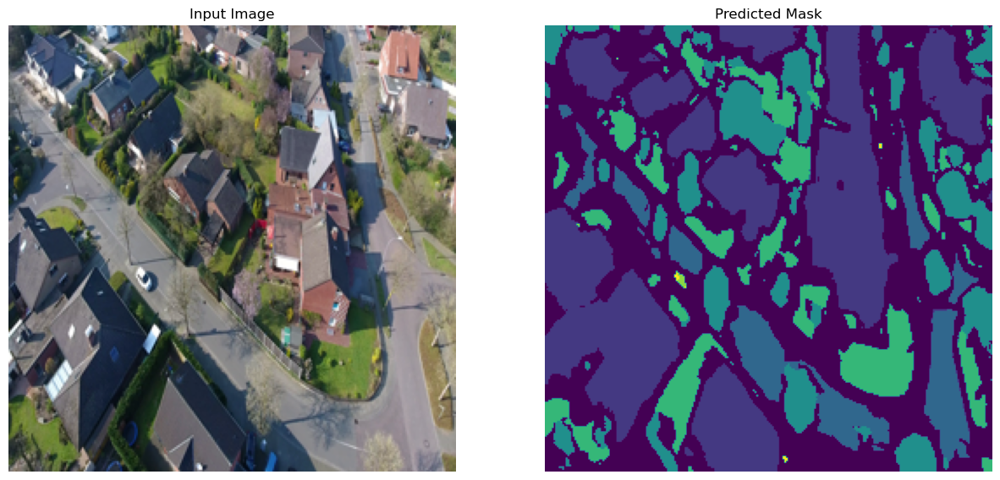

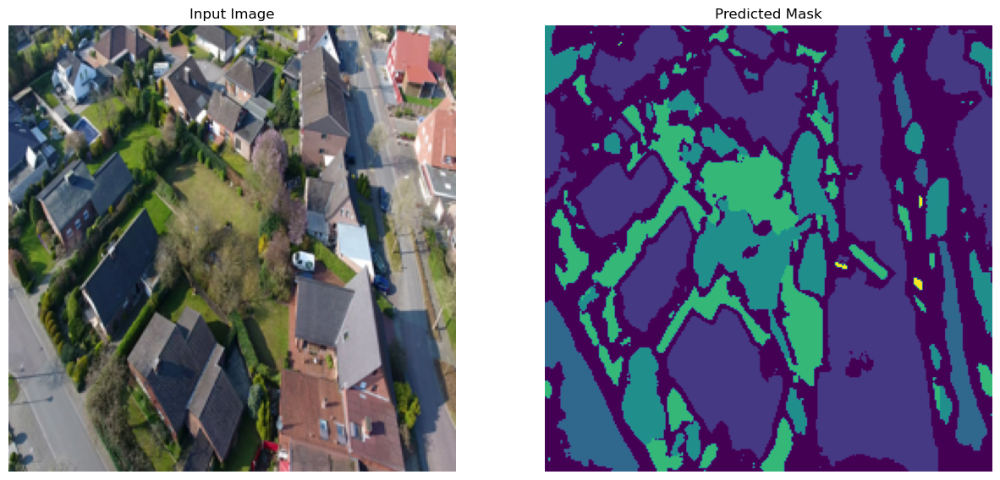

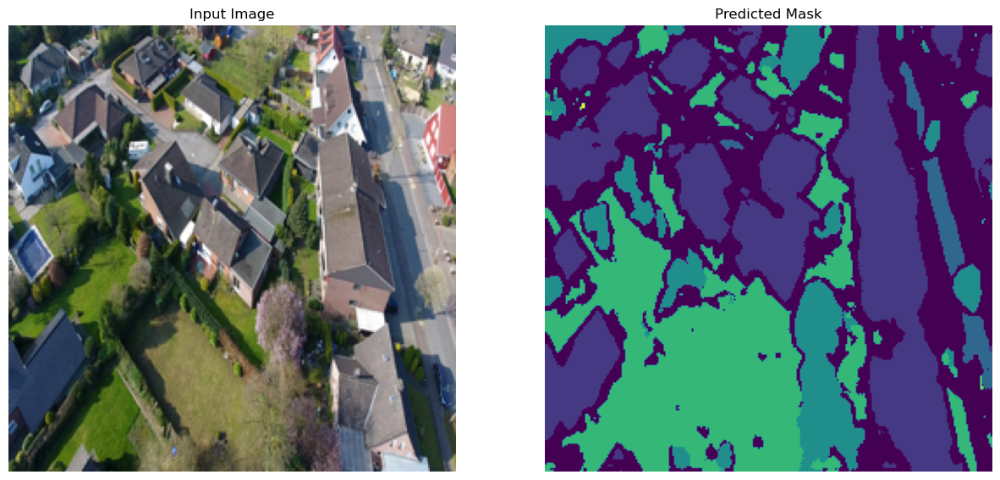

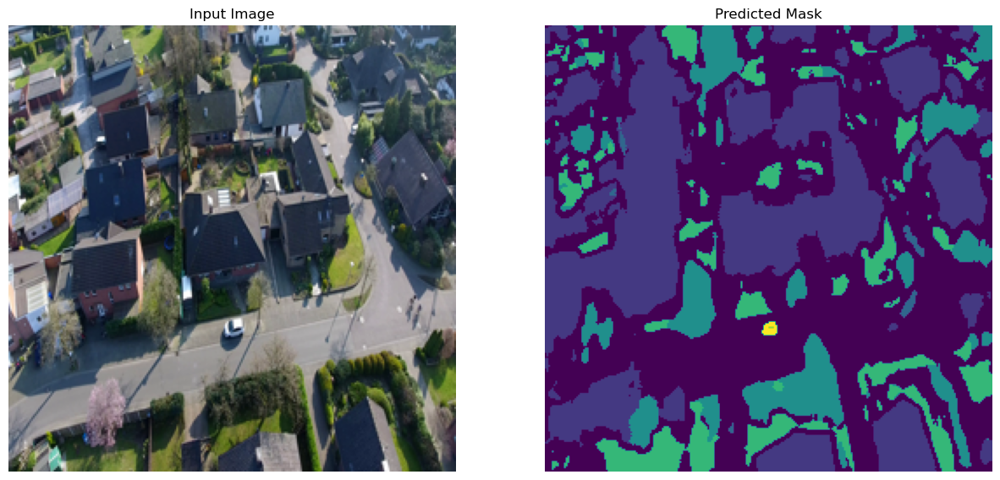

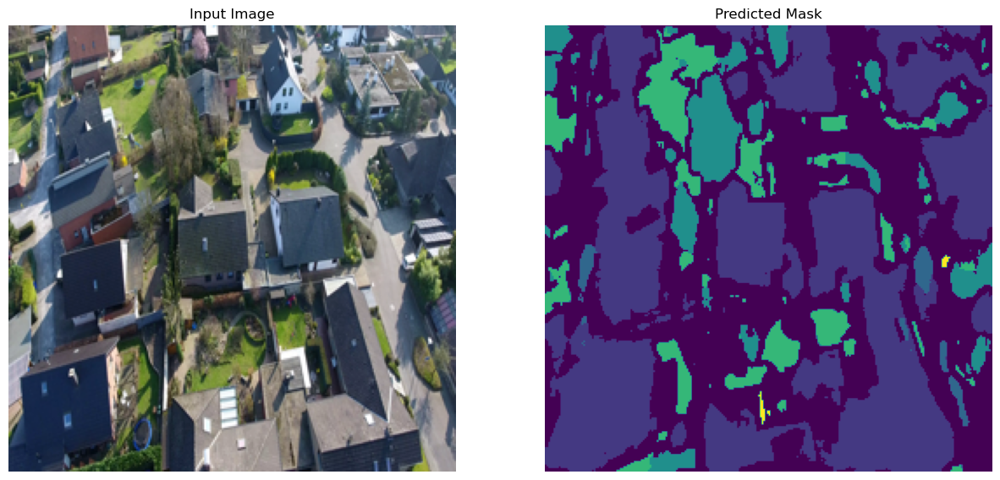

...

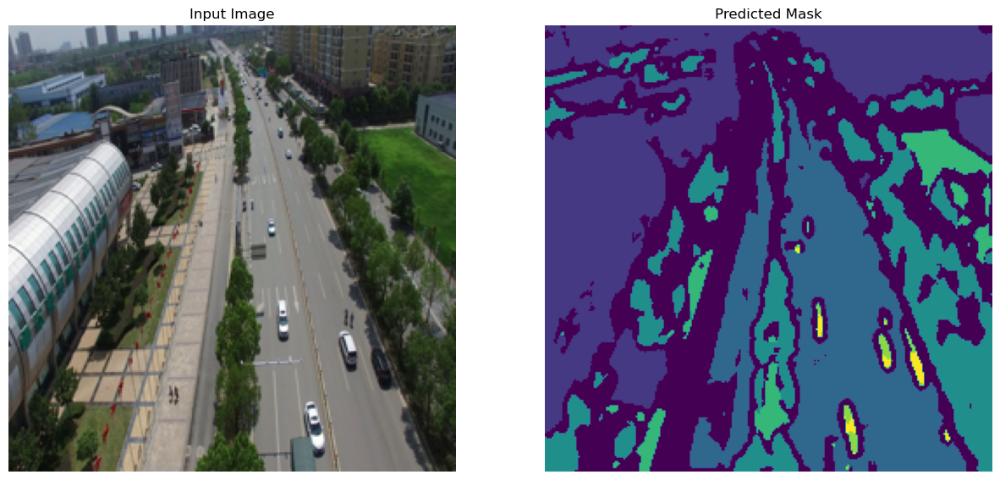

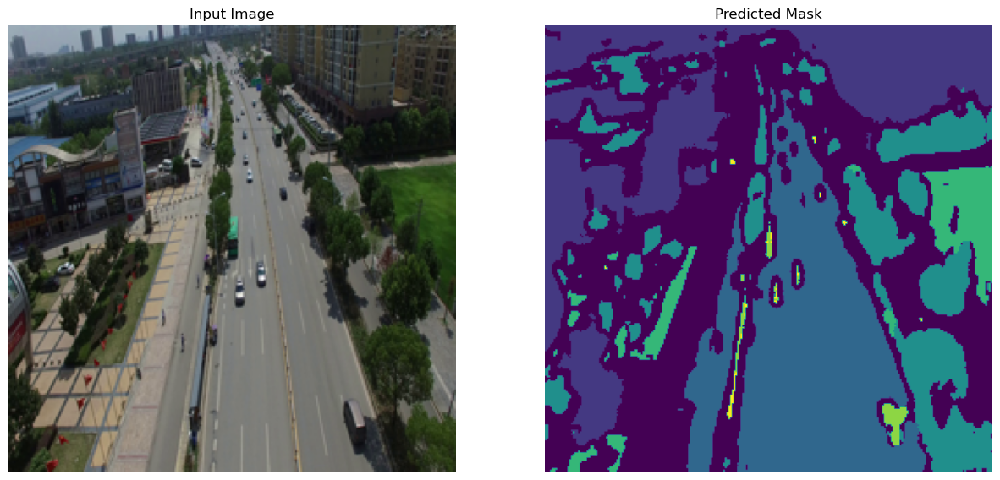

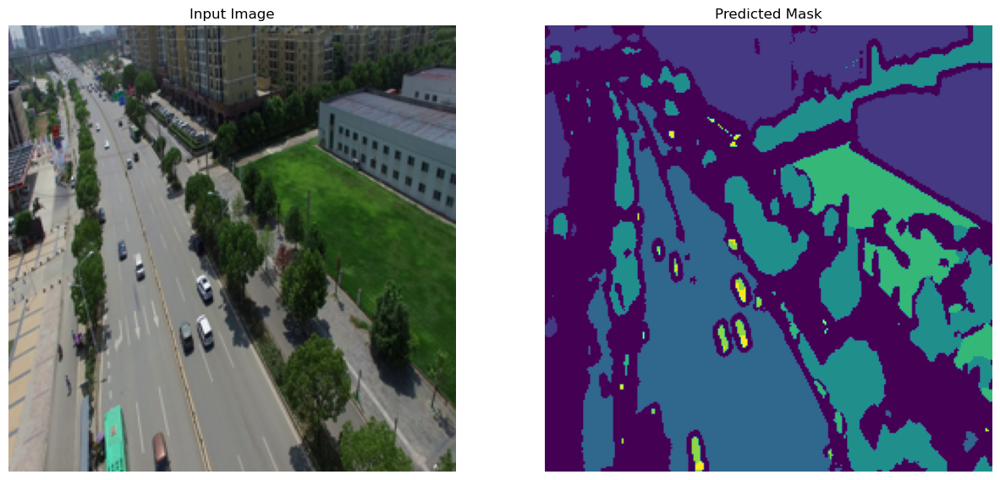

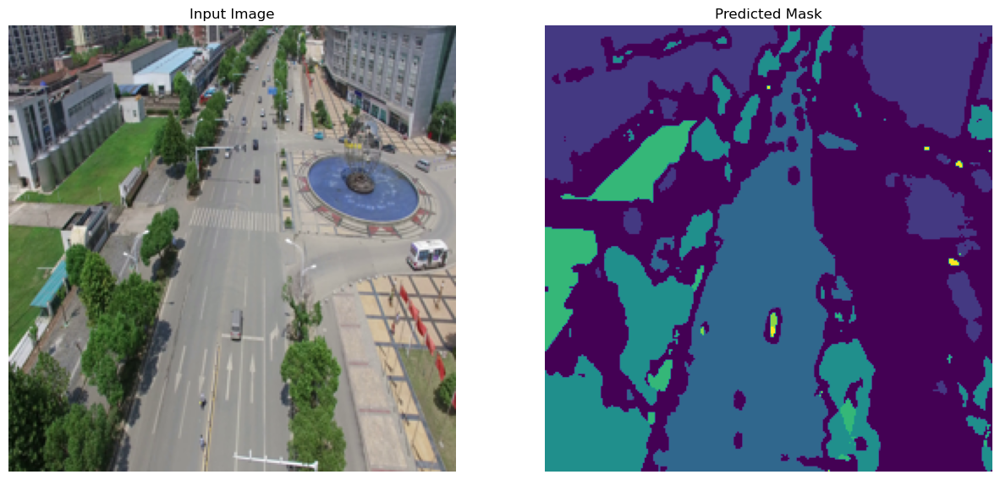

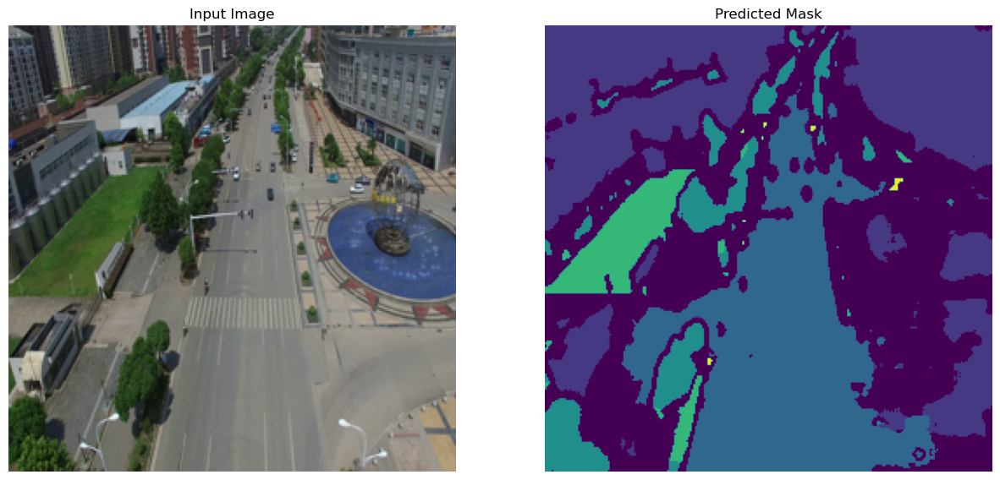

In [8]:
j=0
for i in range(100,120):
    display([test_images[i],create_mask(predictions_list[j])])
    j=j+1

In [ ]:
#################################################################3

In [9]:
loaded_model2 = load_model(r"C:\Users\LENOVO\Downloads\residual_unet_model.h5")

In [10]:
predictions_list2 = []


for i in range(100,120):
   
    image = np.expand_dims(test_images[i], axis=0)  
    
    
    prediction = loaded_model2.predict(image)
    
   
    predictions_list2.append(prediction)

1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


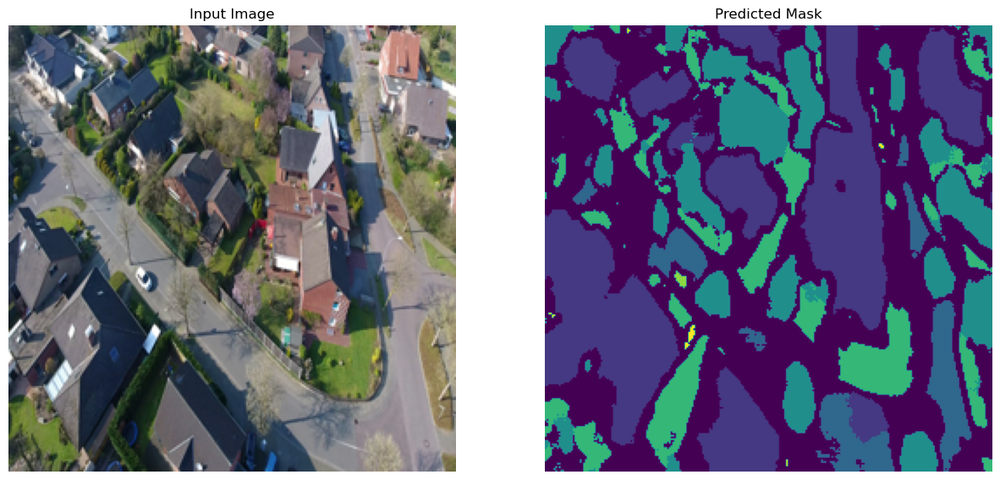

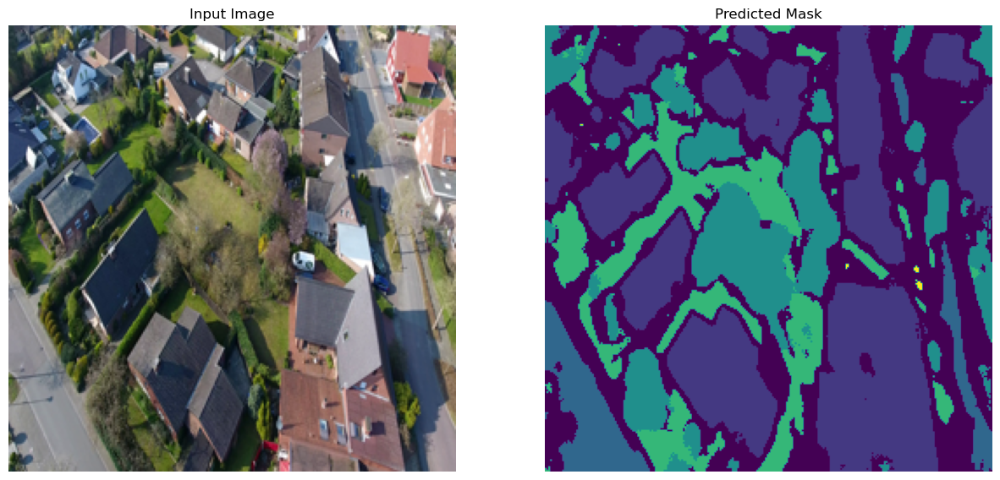

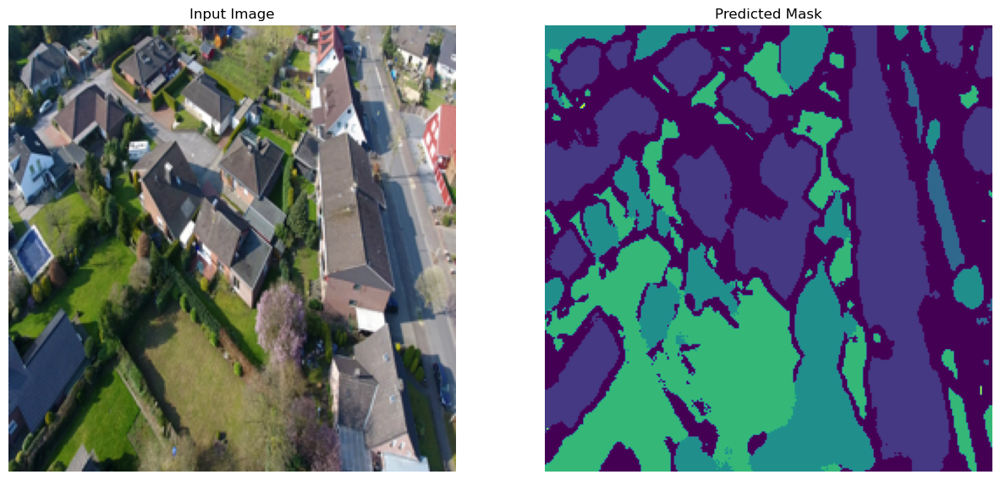

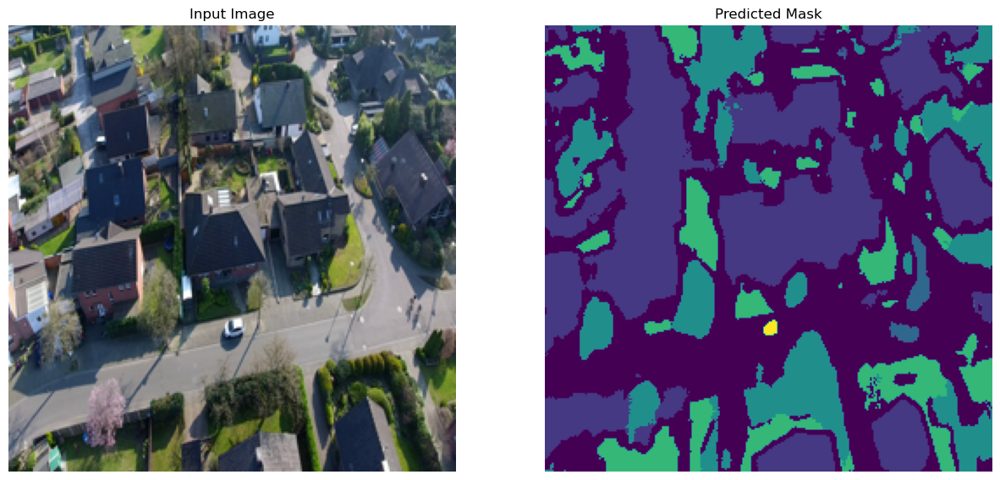

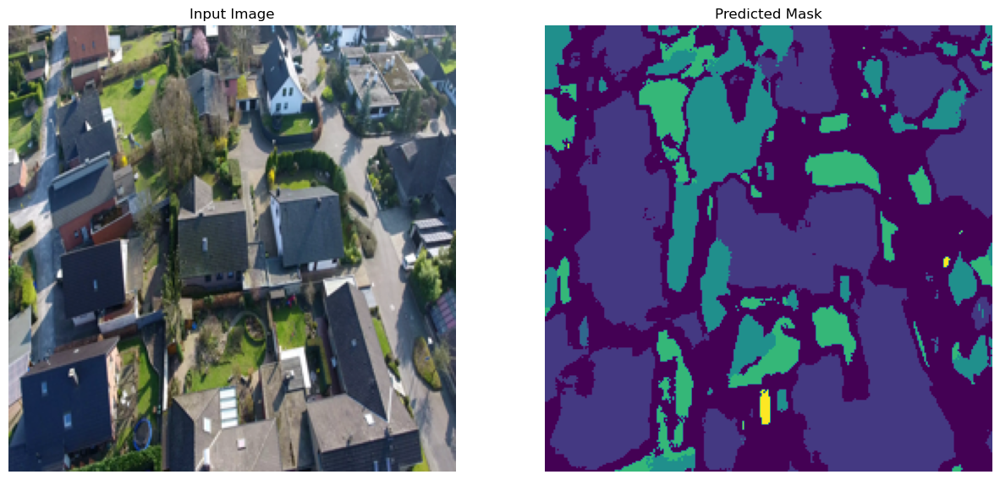

...

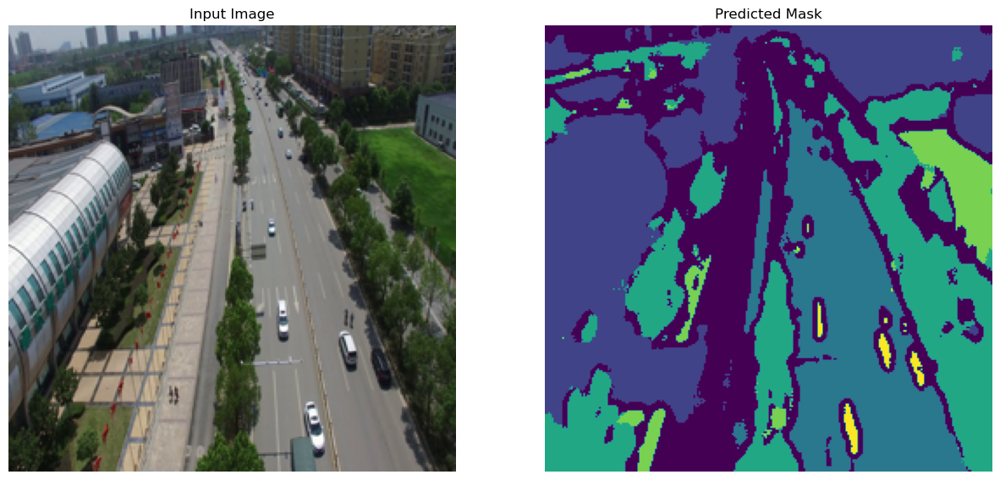

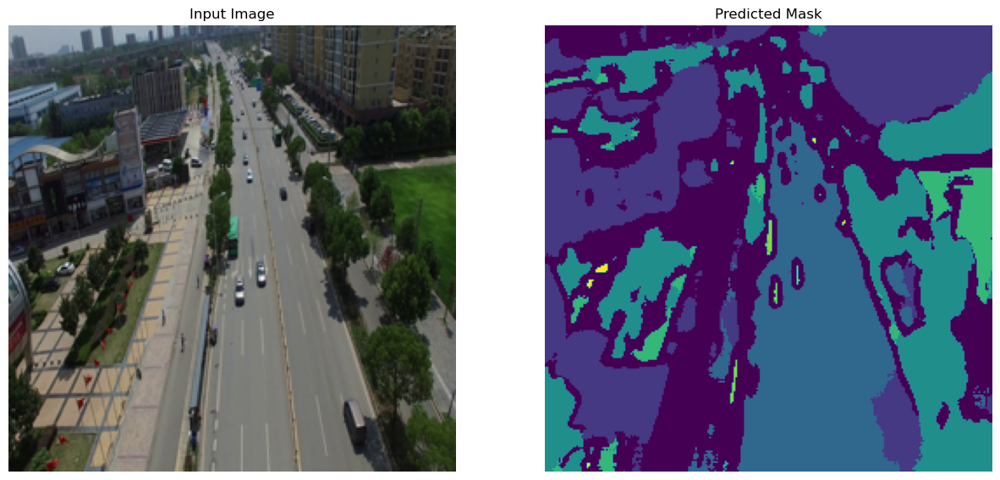

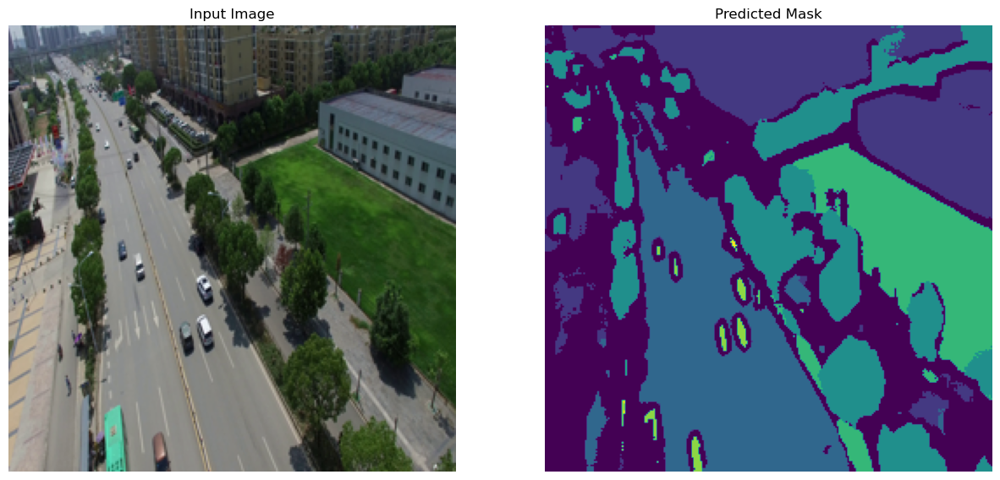

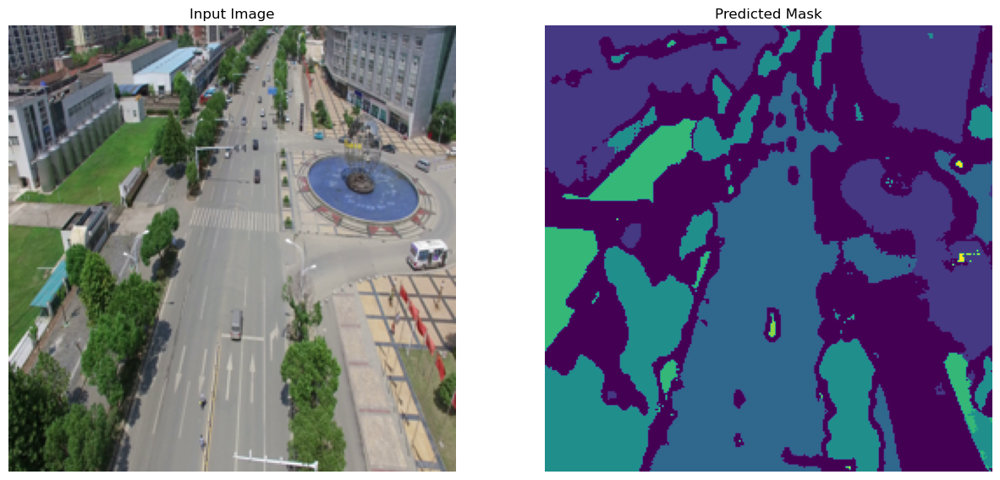

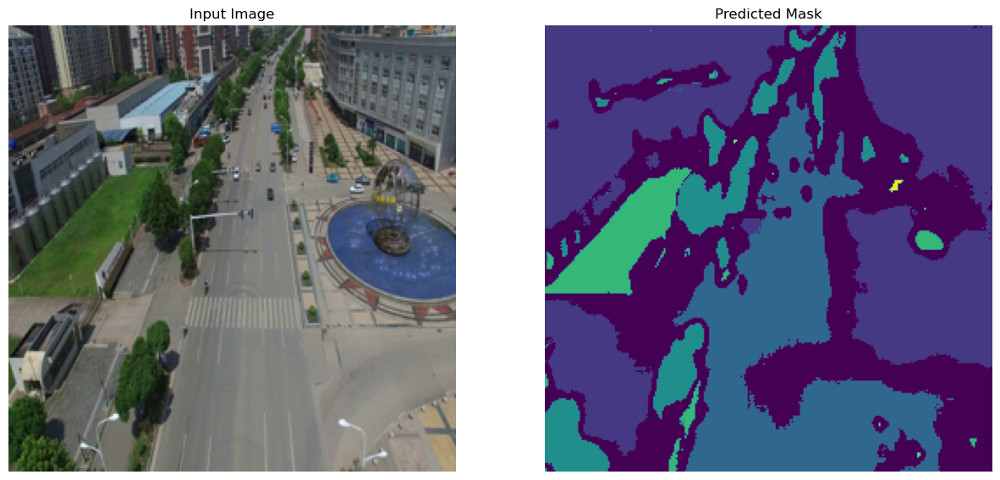

In [11]:
j=0
for i in range(100,120):
    display([test_images[i],create_mask(predictions_list2[j])])
    j=j+1

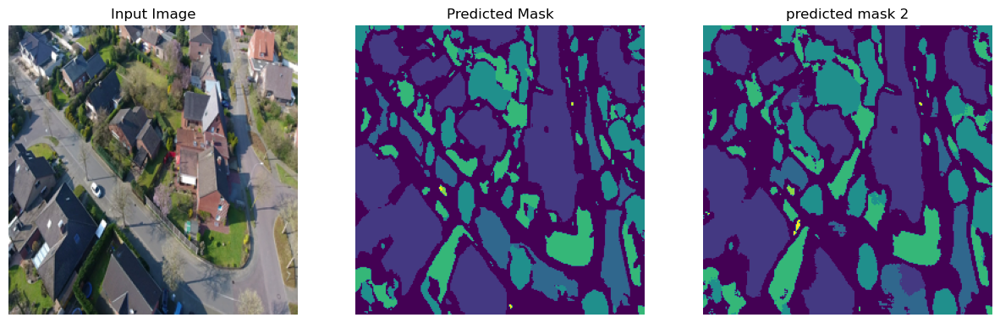

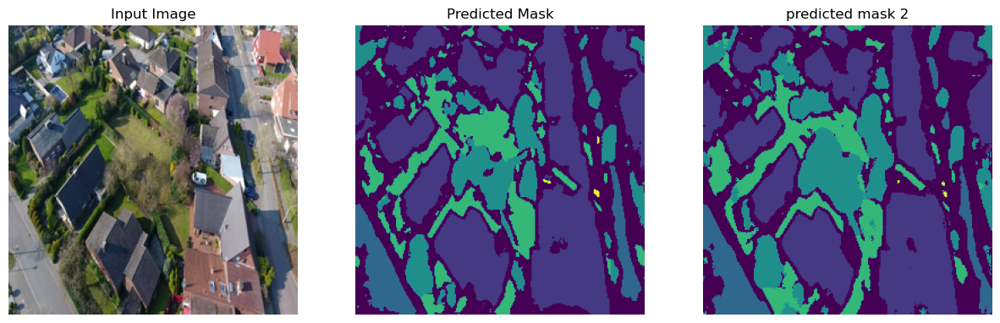

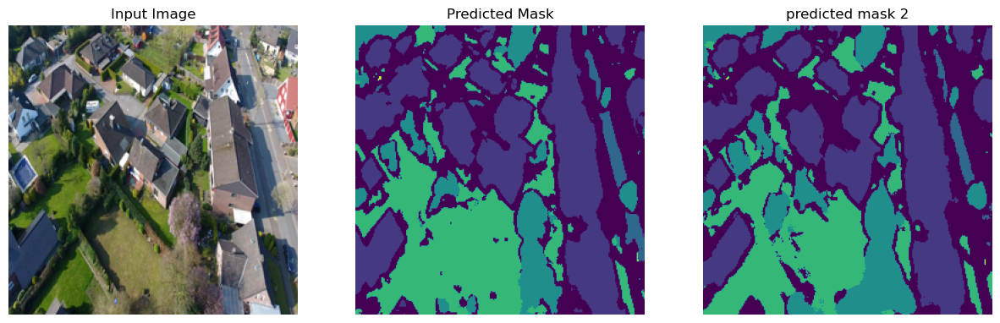

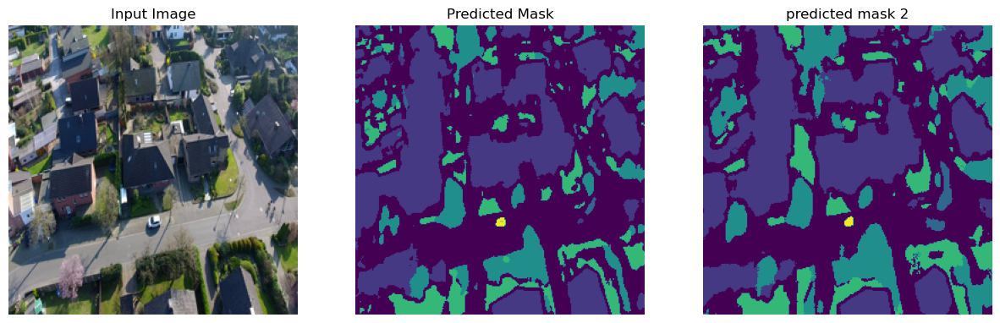

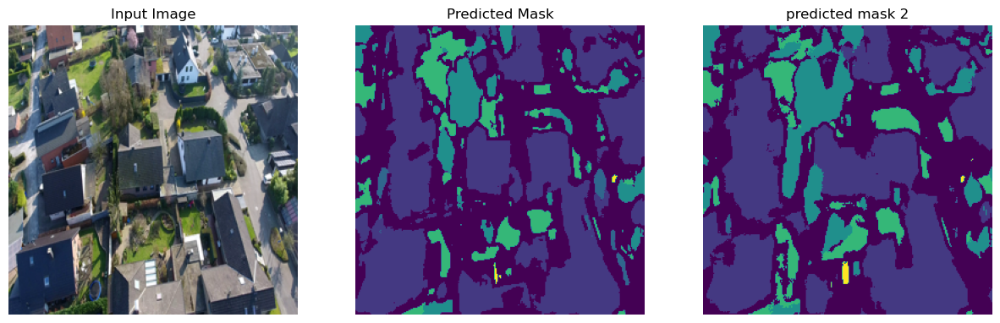

...

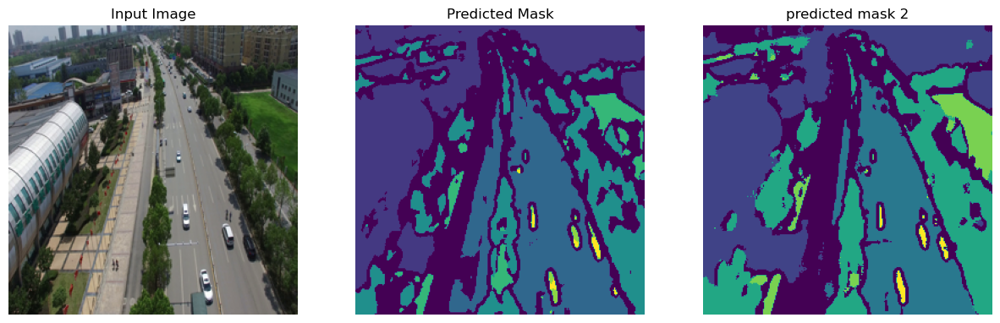

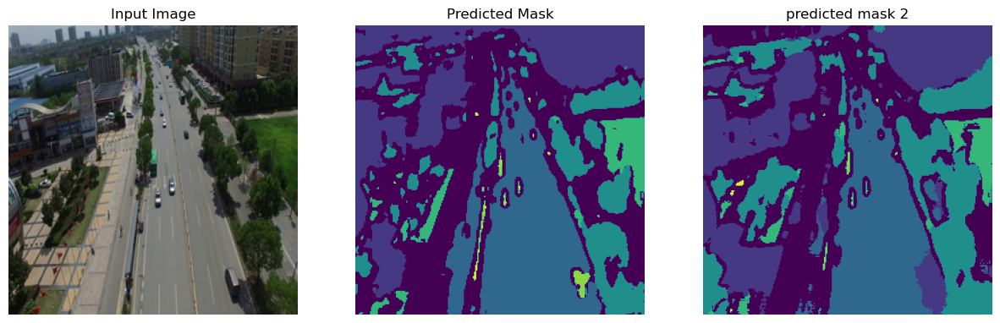

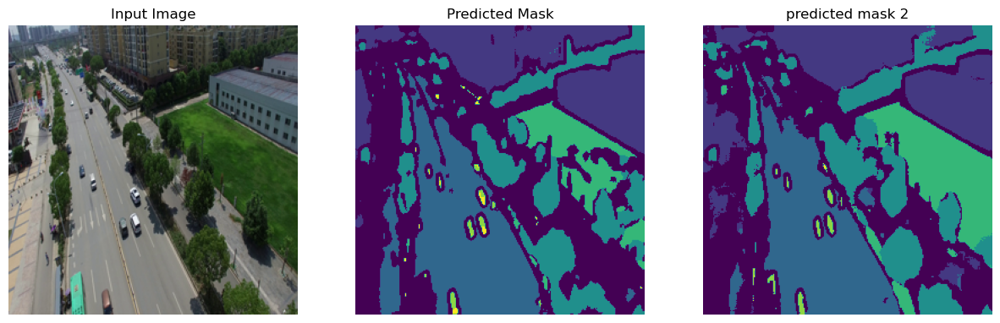

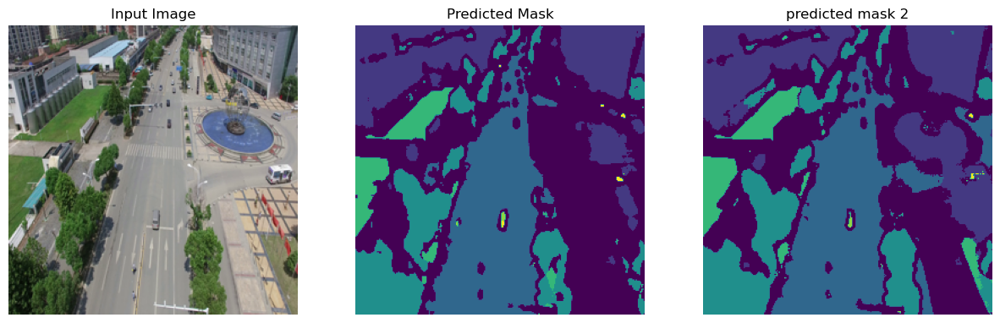

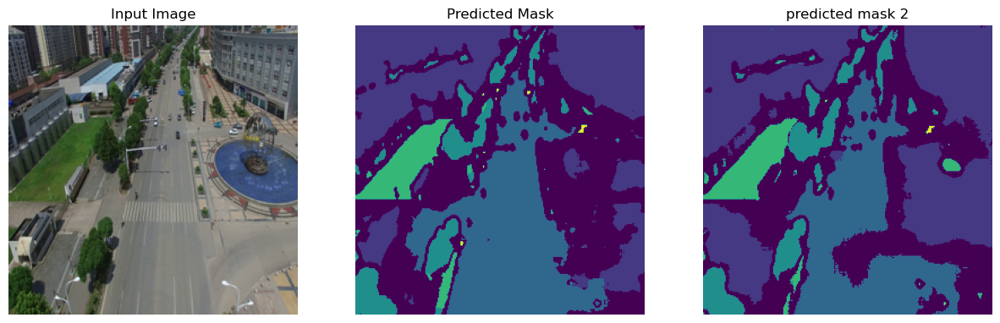

In [12]:
def display2(display_list):
    plt.figure(figsize=(15, 15))

    title = ['Input Image', 'Predicted Mask','predicted mask 2']

    for i in range(len(display_list)):
        plt.subplot(1, len(display_list), i+1)
        plt.title(title[i])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(display_list[i]))
        plt.axis('off')
    plt.show()
j=0
for i in range(100,120):
    display2([test_images[i],create_mask(predictions_list[j]),create_mask(predictions_list2[j])])
    j=j+1